In [1]:
import pandas as pd
import numpy as np
import matplotlib.pyplot as plt
from scipy.stats import skew
import seaborn as sns
from sklearn.preprocessing import LabelEncoder, OneHotEncoder


plt.style.use('seaborn')
sns.set(font_scale=2.5)

import missingno as msno

import warnings
warnings.filterwarnings('ignore')

%matplotlib inline

In [2]:
class Suicides(object):    
    def __init__(self):
        self.df = suicides.df
        self.df_test = suicides.df_test
        self.df_all_feature_var_names = []
        self.df_test_all_feature_var_names = []
        
    _non_numerical_feature_names = []
    _numerical_feature_names = []
    _is_one_hot_encoder = 0
    _feature_names_num = []
    _is_not_import_data = 0
    
    
    df = pd.read_csv('./train.csv')
    df_test = pd.read_csv('./test_mini.csv')
    
    
    # 수치형 열을 추출
    def extract_numerical_features(df):
        df = df.copy()
        numerical_features = pd.Series(data=False, index=df.columns, dtype=bool)
        
        for feature in df.columns:
            if any(tuple(df[feature].map(lambda x: type(x)) == int)) or \
                any(tuple(df[feature].map(lambda x: type(x)) == float)) & \
                    (not any(tuple(df[feature].map(lambda x: type(x)) == str))):
                numerical_features[feature] = 1
    
        return numerical_features[numerical_features == 1].index
    
    # 수치형을 제외한 열을 추출
    def extract_non_numerical_features(df):
        df = df.copy()
    
        return df.select_dtypes(exclude=[np.number])
    
    # 범주형을 수치형으로 바꿔서 새로운 열 생성
    def encode_labels_in_numeric_format(df, estimated_var):
        feature_names_num = ''.join([estimated_var, '_count'])
        mask = ~df[estimated_var].isnull()
        df[feature_names_num] = df[estimated_var]
        df.loc[mask, tuple([feature_names_num])] = df[estimated_var].factorize()[0][mask[mask==1].index]
    
    # 범주형 자료 내에 있는 범주의 종류를 반환
    def label_classes(df, estimated_var):
        le = LabelEncoder()
        le.fit(df[estimated_var].values)
        
        return le.classes_
    
    # 범주형 자료 one hot encoding
    def one_hot_encoder(df, estimated_var):
        df_class = df.copy()
        ohe = OneHotEncoder()
        label_classes = df_class[estimated_var].factorize()[1]
        new_one_hot_encoded_features = [''.join([estimated_var, '_', x]) for x in label_classes]
        mask = ~df[estimated_var].isnull()
        feature_var_values = ohe.fit_transform(np.reshape(np.array(df[''.join([estimated_var, '_count'])][mask].values), 
                                                      (df[mask].shape[0], 1))).toarray().astype(int)

        for ite in new_one_hot_encoded_features:
            df[ite] = df[estimated_var]
        df.loc[mask, tuple(new_one_hot_encoded_features)] = feature_var_values

In [3]:
train = Suicides.df
test = Suicides.df_test

train.gdp_for_year = train.gdp_for_year.map(lambda x: x.replace(',','')).astype(float)

In [4]:
train.head()

,country,year,sex,age,suicides_no,population,suicides_100k_pop,country_year,HDI_for_year,gdp_for_year,gdp_per_capital,generation
0,Albania,1987,male,15-24 years,21,312900,6.71,Albania1987,NaN,2.156625e+09,796,Generation X
1,Albania,1987,male,35-54 years,16,308000,5.19,Albania1987,NaN,2.156625e+09,796,Silent
2,Albania,1987,female,15-24 years,14,289700,4.83,Albania1987,NaN,2.156625e+09,796,Generation X
3,Albania,1987,male,75+ years,1,21800,4.59,Albania1987,NaN,2.156625e+09,796,G.I. Generation
4,Albania,1987,male,25-34 years,9,274300,3.28,Albania1987,NaN,2.156625e+09,796,Boomers


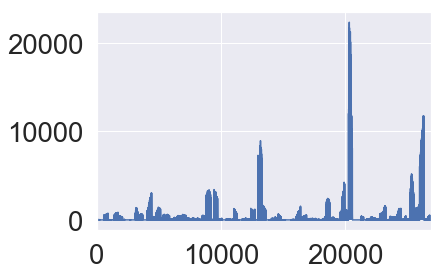

In [5]:
y = train.suicides_no

train.suicides_no.plot.line()

In [6]:
def skew_correction(df, numerical_features):
    # Skew correction
    # compute skewness
    skewed_feats = df[numerical_features].apply(lambda x: skew(x.dropna()))  
    skewed_feats = skewed_feats[skewed_feats > 0.75]
    skewed_feats = skewed_feats.index
    df.loc[:, tuple(skewed_feats)] = np.log1p(np.asarray(df[skewed_feats], dtype=float))
    # df[skewed_feats] = np.log1p(np.asarray(df[skewed_feats], dtype=float))

In [7]:
for col in train.columns:
    msg = 'columns: {:>10}\t Percent of NaN values: {:.2f}%'.format(col, 100 * (train[col].isnull().sum()/train[col].shape[0]))
    print(msg)

columns:    country	 Percent of NaN values: 0.00%
columns:       year	 Percent of NaN values: 0.00%
columns:        sex	 Percent of NaN values: 0.00%
columns:        age	 Percent of NaN values: 0.00%
columns: suicides_no	 Percent of NaN values: 0.00%
columns: population	 Percent of NaN values: 0.00%
columns: suicides_100k_pop	 Percent of NaN values: 0.00%
columns: country_year	 Percent of NaN values: 0.00%
columns: HDI_for_year	 Percent of NaN values: 68.93%
columns: gdp_for_year	 Percent of NaN values: 0.00%
columns: gdp_per_capital	 Percent of NaN values: 0.00%
columns: generation	 Percent of NaN values: 0.00%


In [8]:
for col in test.columns:
    msg = 'columns: {:>10}\t Percent of NaN values: {:.2f}%'.format(col, 100 * (test[col].isnull().sum()/test[col].shape[0]))
    print(msg)

columns:    country	 Percent of NaN values: 0.00%
columns:       year	 Percent of NaN values: 0.00%
columns:        sex	 Percent of NaN values: 0.00%
columns:        age	 Percent of NaN values: 0.00%
columns: population	 Percent of NaN values: 0.00%
columns: suicides_100k_pop	 Percent of NaN values: 0.00%
columns: country_year	 Percent of NaN values: 0.00%
columns: HDI_for_year	 Percent of NaN values: 100.00%
columns: gdp_for_year	 Percent of NaN values: 0.00%
columns: gdp_per_capital	 Percent of NaN values: 0.00%
columns: generation	 Percent of NaN values: 0.00%


In [9]:
train.age.unique() # age는 범주형으로 one hot encoding

array(['15-24 years', '35-54 years', '75+ years', '25-34 years',
       '55-74 years', '5-14 years'], dtype=object)

In [10]:

#train.gdp_for_year = train.gdp_for_year.map(lambda x: x.replace(',', '')) -> 이건 굳이 안넣어도 될듯
train.head()

,country,year,sex,age,suicides_no,population,suicides_100k_pop,country_year,HDI_for_year,gdp_for_year,gdp_per_capital,generation
0,Albania,1987,male,15-24 years,21,312900,6.71,Albania1987,NaN,2.156625e+09,796,Generation X
1,Albania,1987,male,35-54 years,16,308000,5.19,Albania1987,NaN,2.156625e+09,796,Silent
2,Albania,1987,female,15-24 years,14,289700,4.83,Albania1987,NaN,2.156625e+09,796,Generation X
3,Albania,1987,male,75+ years,1,21800,4.59,Albania1987,NaN,2.156625e+09,796,G.I. Generation
4,Albania,1987,male,25-34 years,9,274300,3.28,Albania1987,NaN,2.156625e+09,796,Boomers


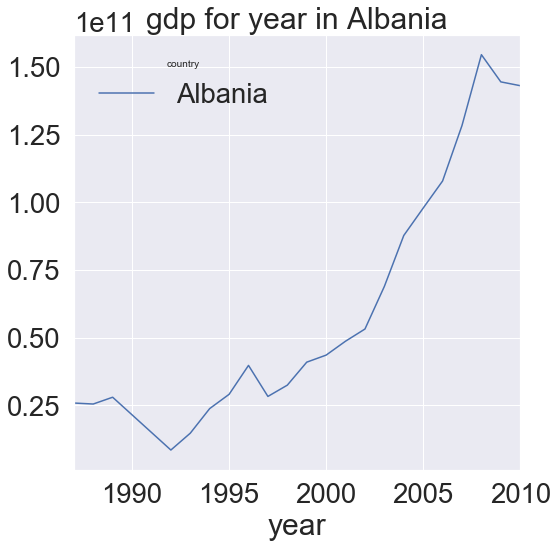

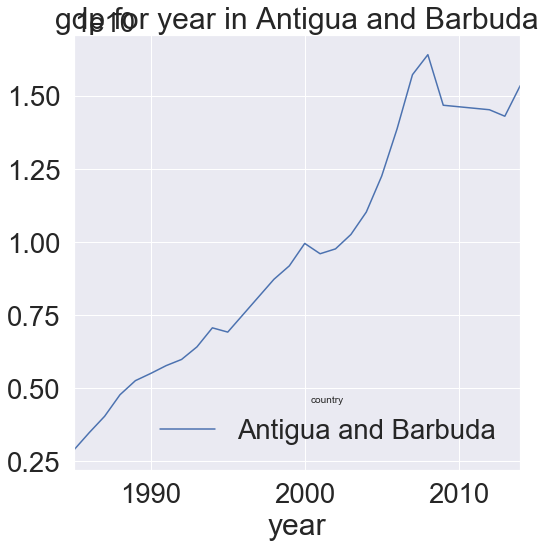

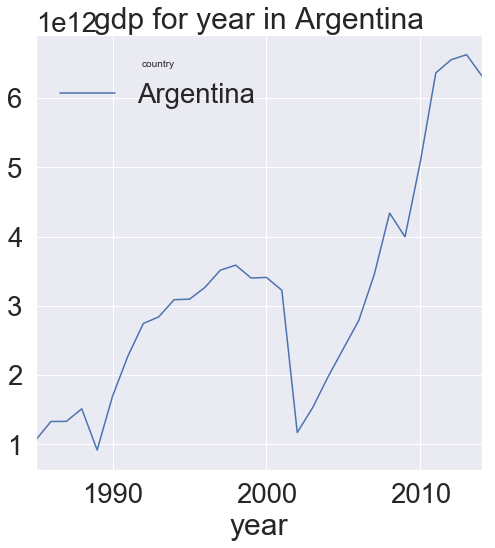

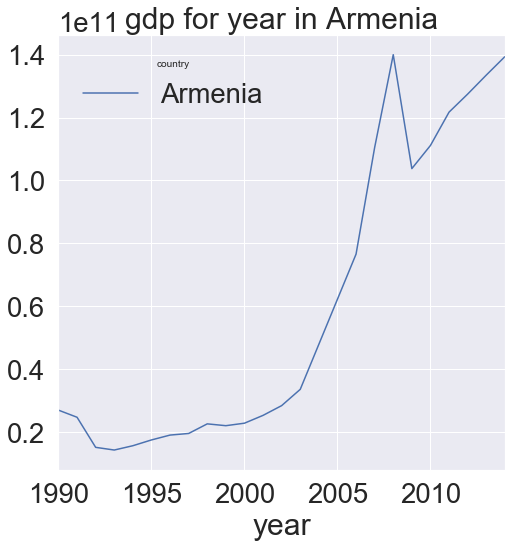

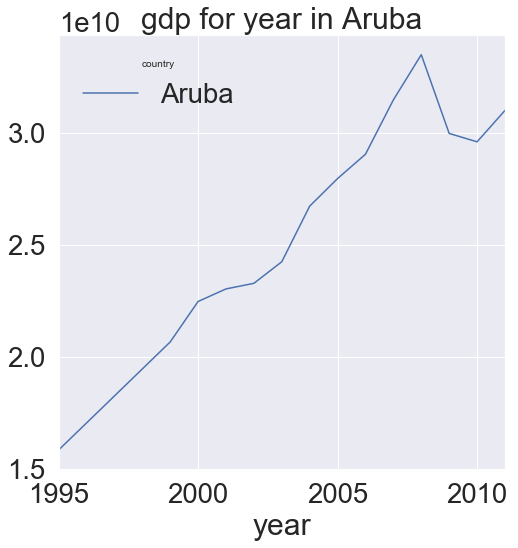

...

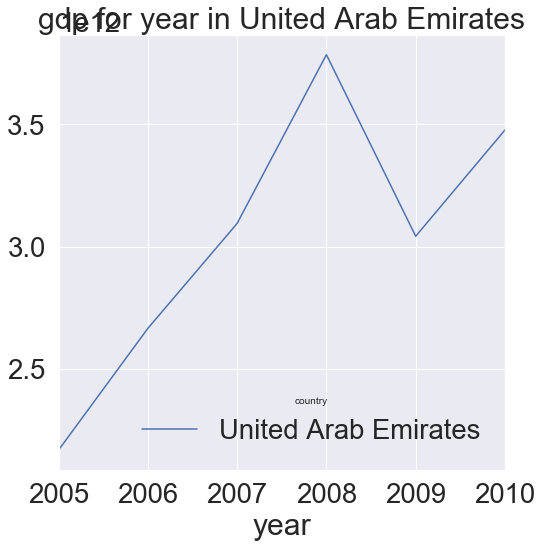

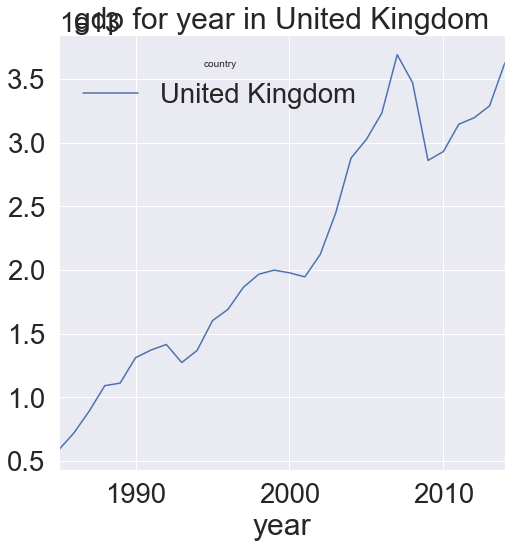

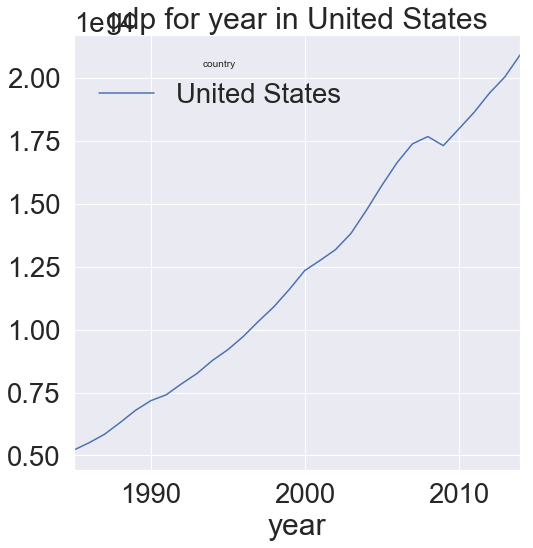

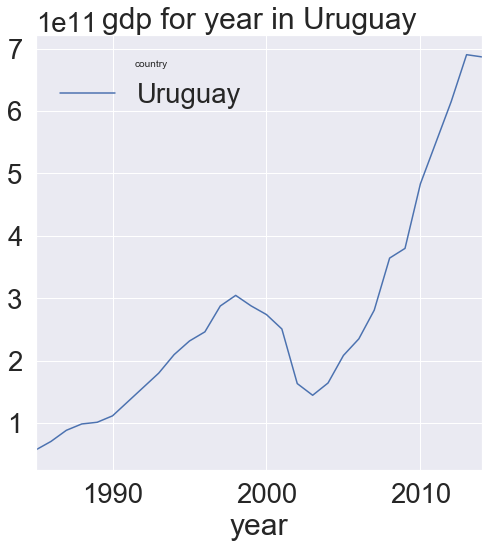

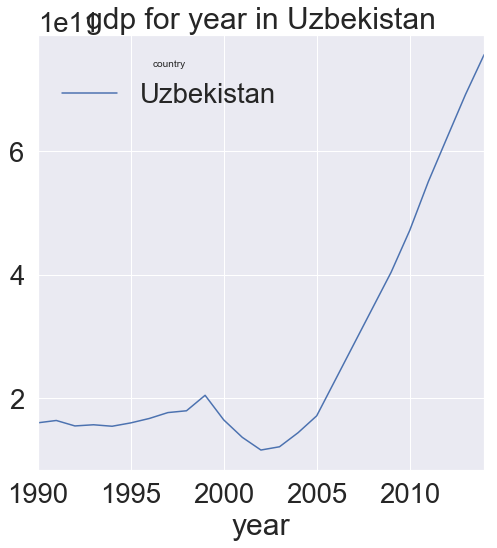

In [11]:
for country in train.country.unique():
    grouped = train[train['country'] == country].groupby(['country', 'year'])['gdp_for_year'].sum().unstack('country')
    grouped.plot(figsize=(8, 8),
               title='gdp for year in '+ country,
               legend=True)

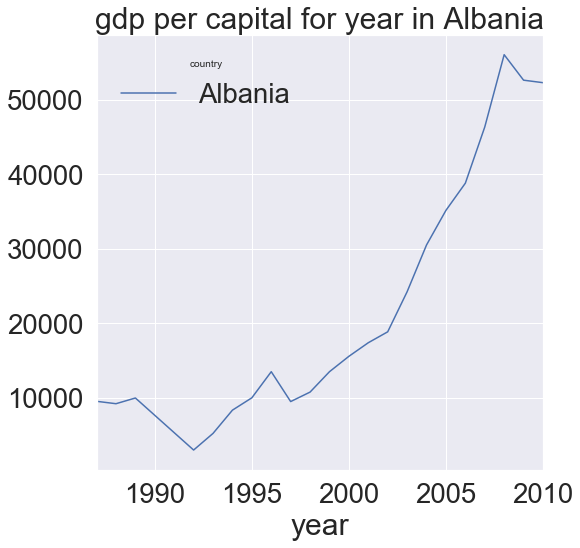

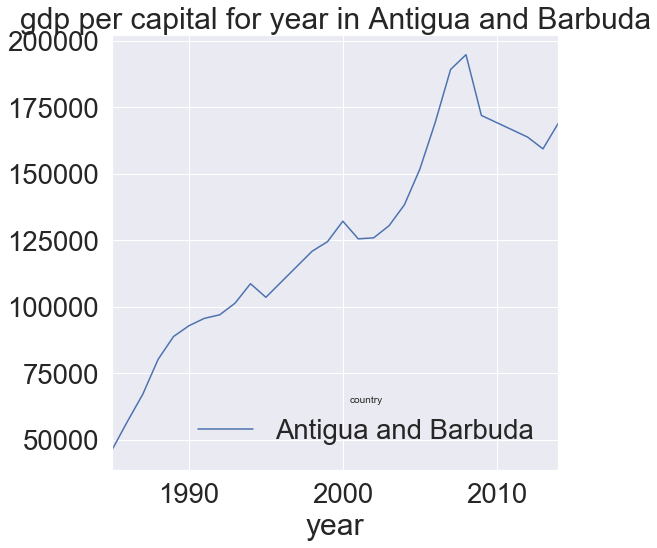

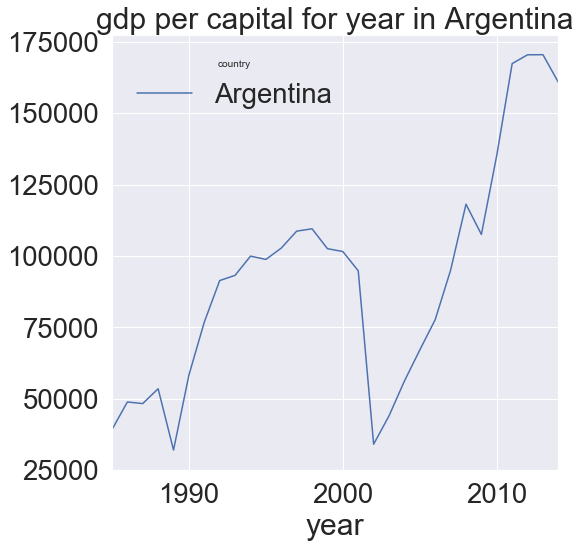

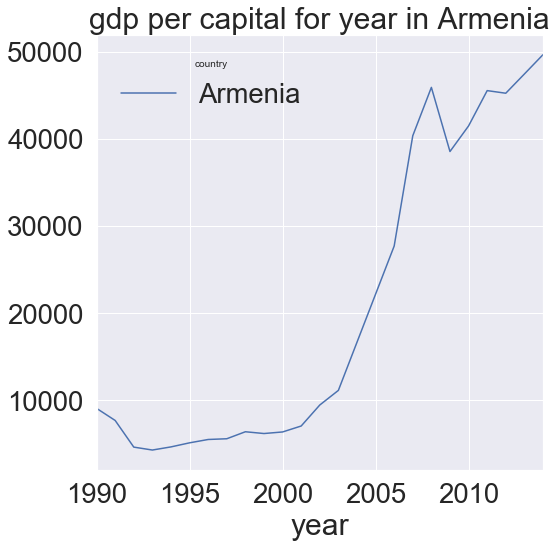

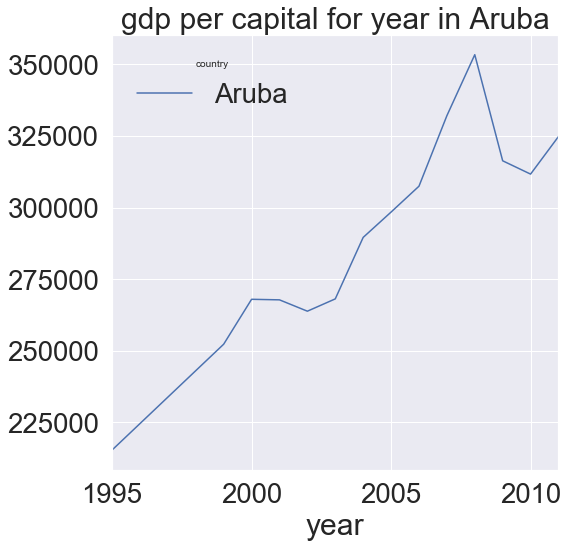

...

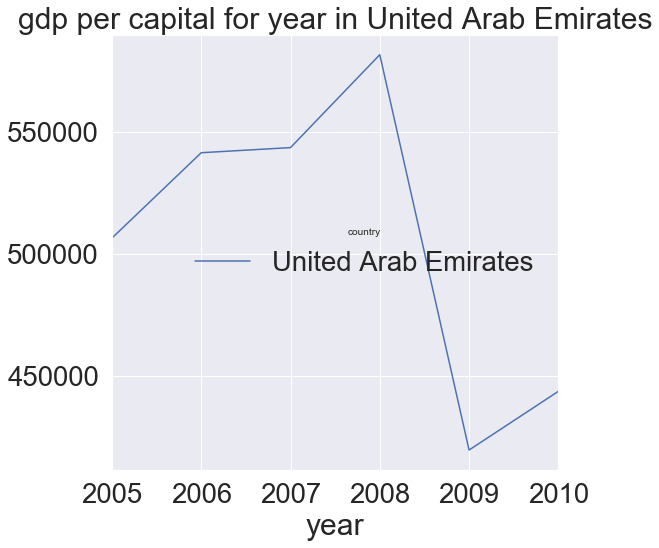

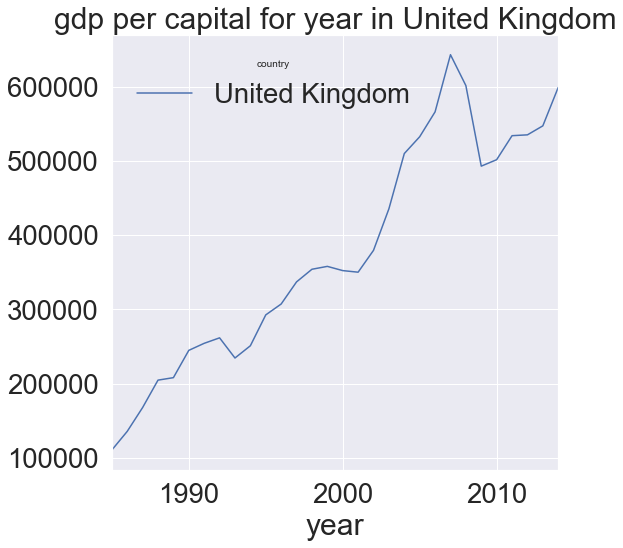

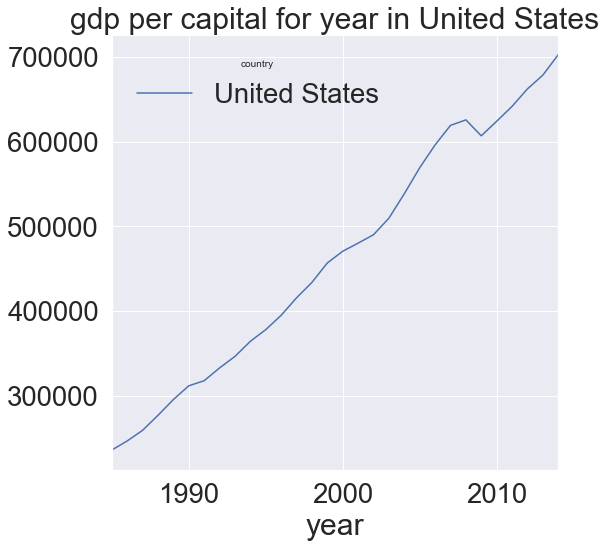

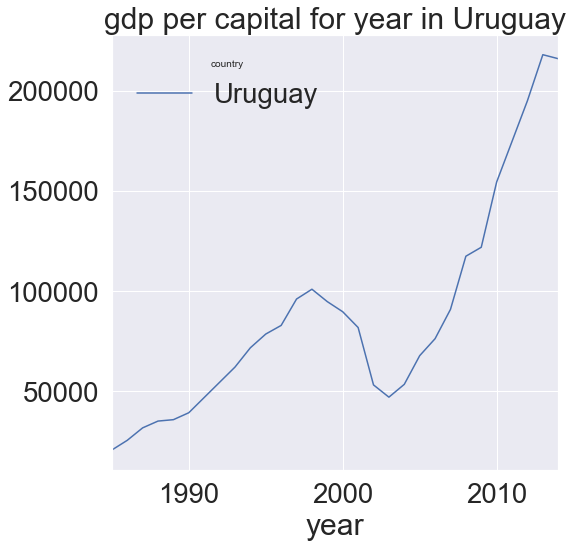

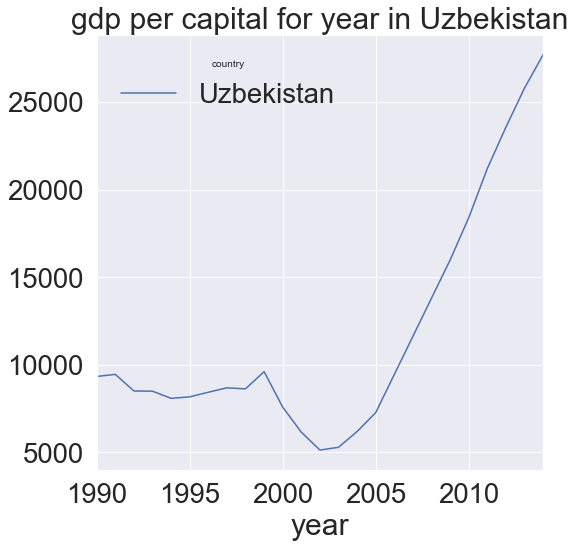

In [12]:
for country in train.country.unique():
    grouped = train[train['country'] == country].groupby(['country', 'year'])['gdp_per_capital'].sum().unstack('country')
    grouped.plot(figsize=(8, 8),
               title='gdp per capital for year in '+ country,
               legend=True)

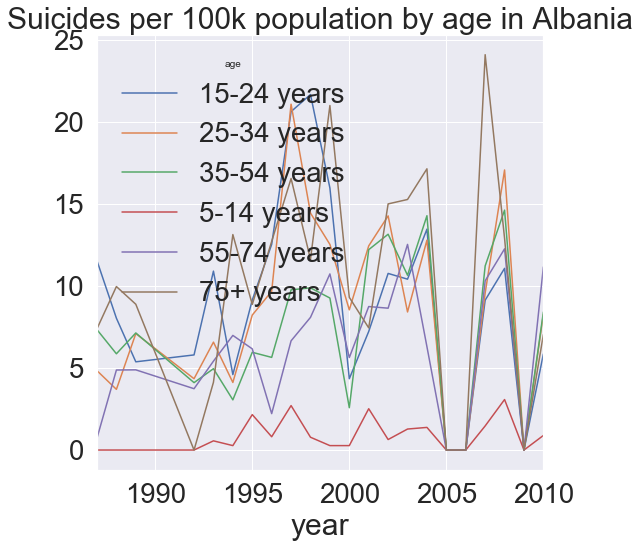

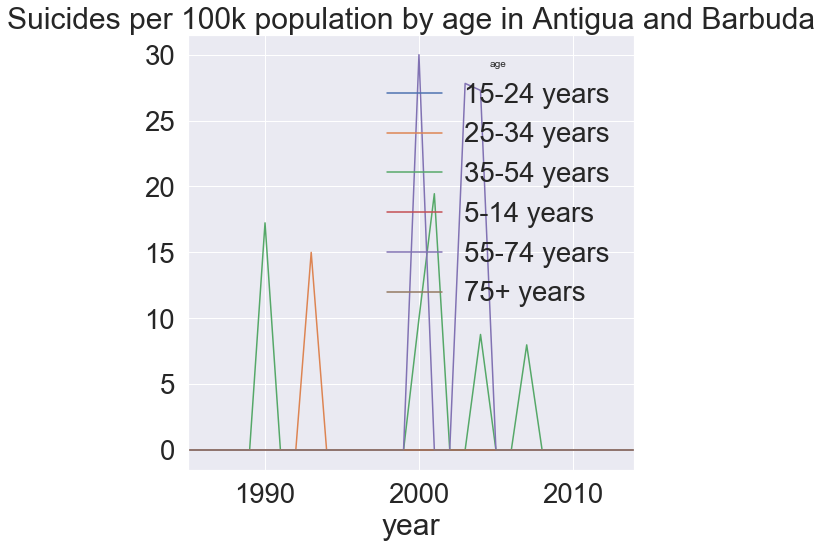

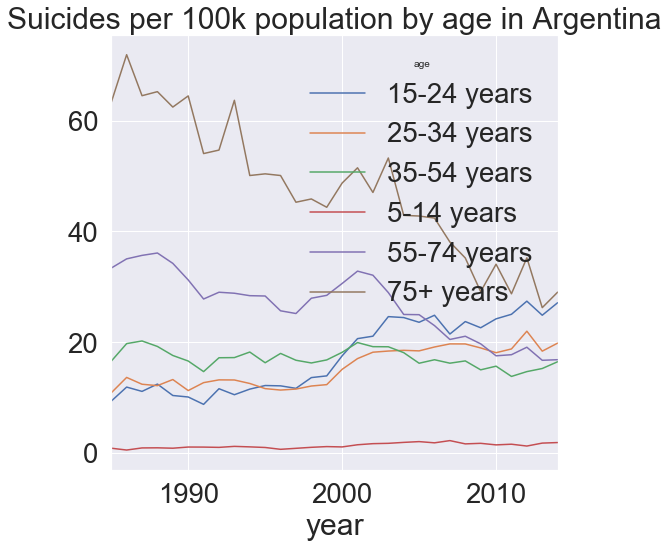

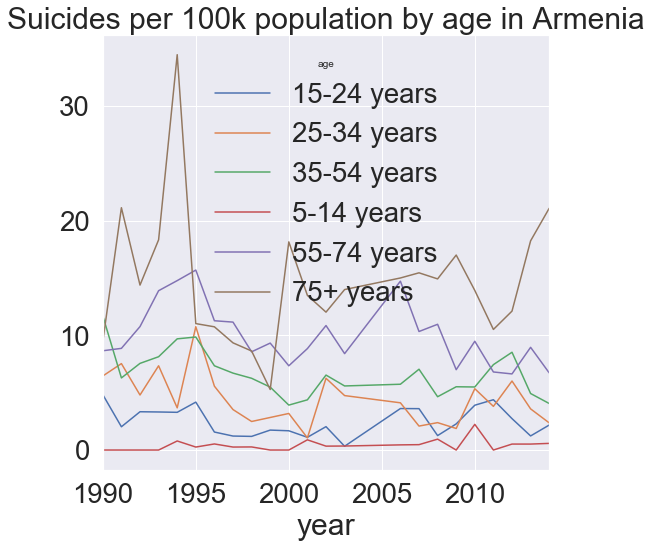

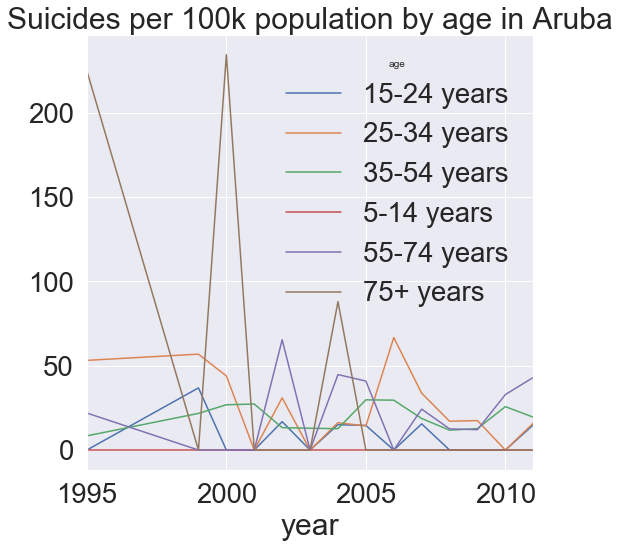

...

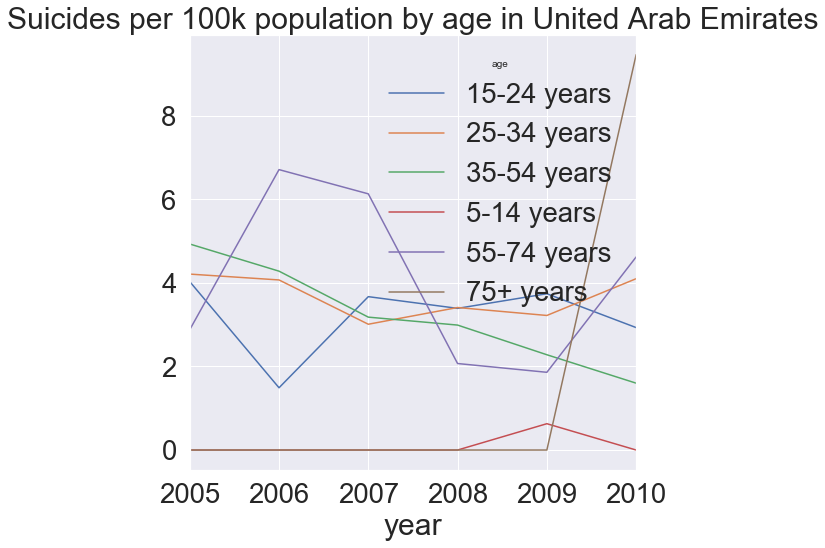

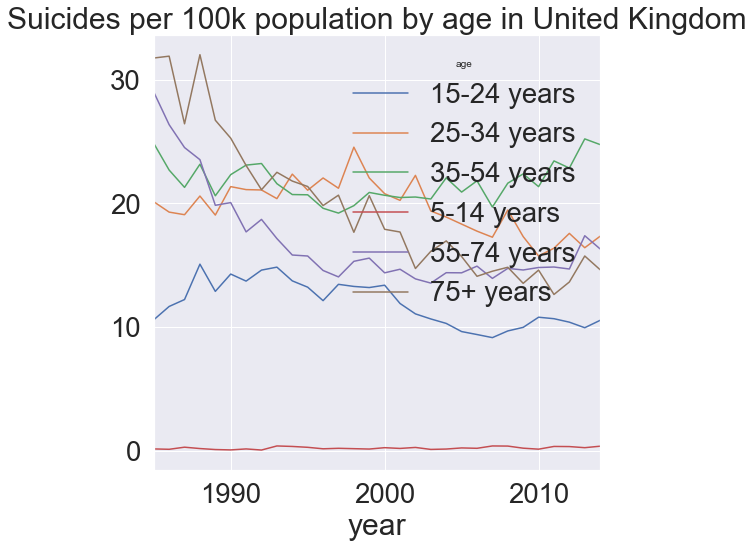

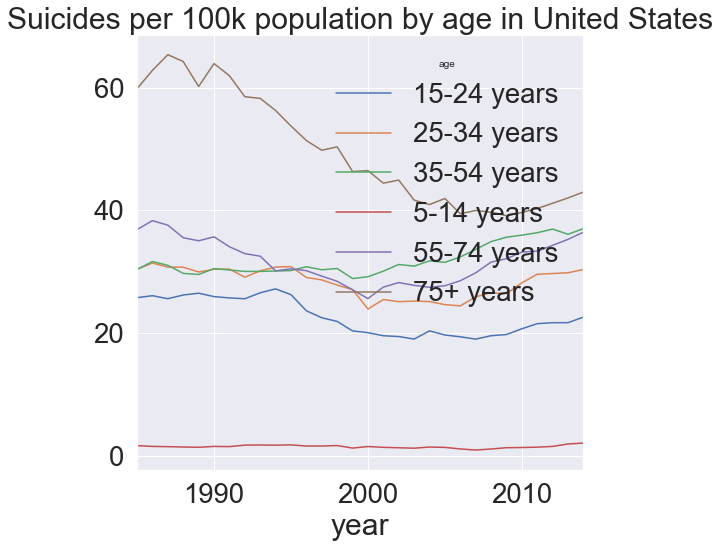

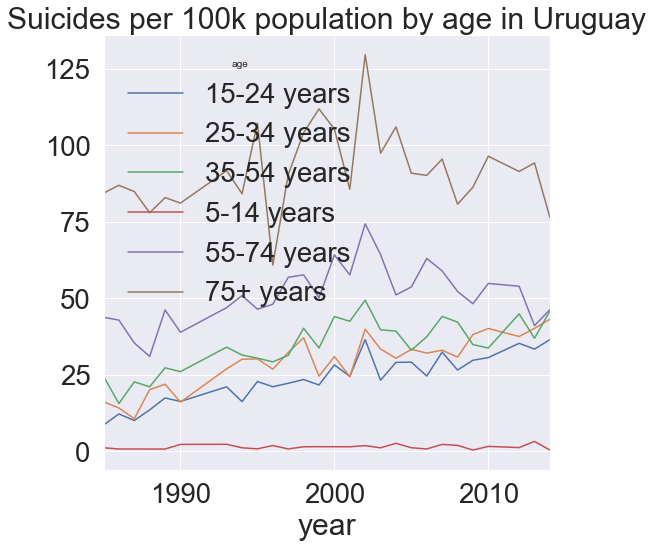

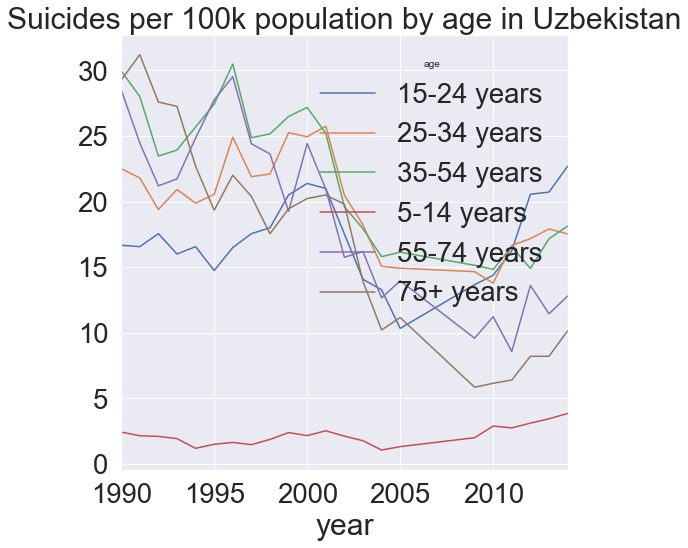

In [13]:
# 연령대에 따른 인구 10만명 당 자살률
for country in train.country.unique():
    grouped = train[train['country'] == country].groupby(['year', 'age'])['suicides_100k_pop'].sum().unstack('age')
    grouped.plot(figsize=(8, 8),
               title='Suicides per 100k population by age in '+ country,
               legend=True)

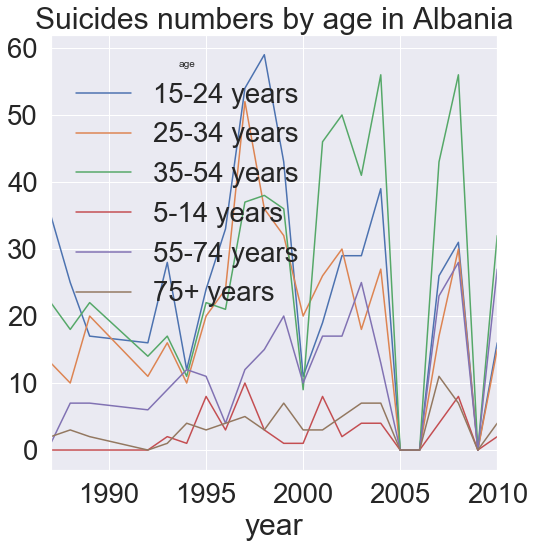

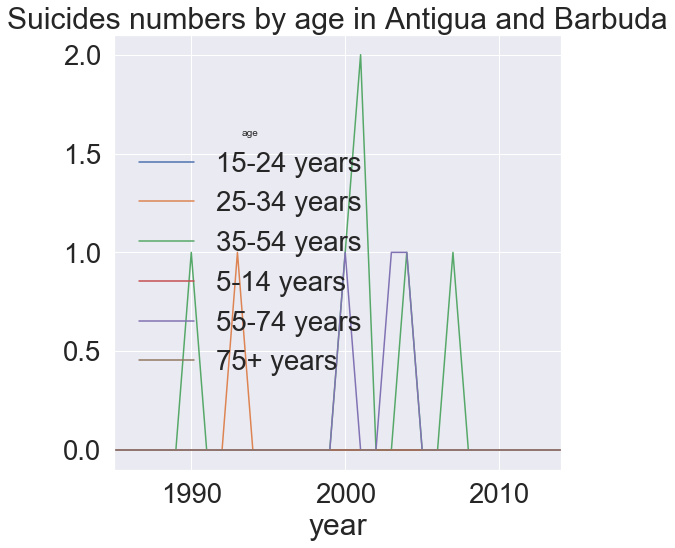

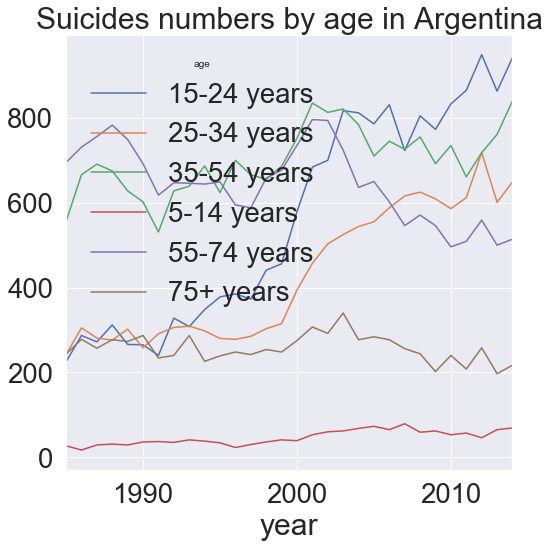

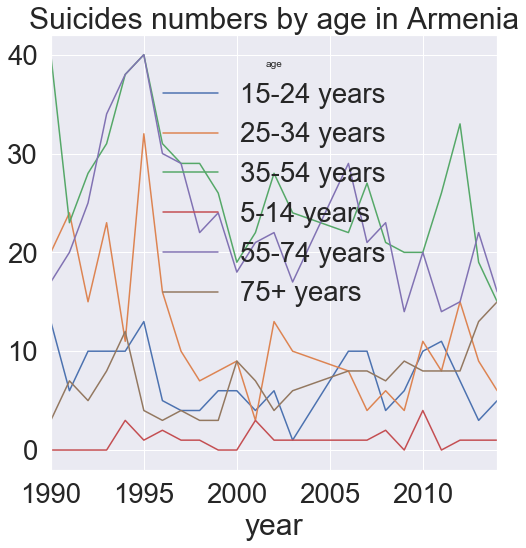

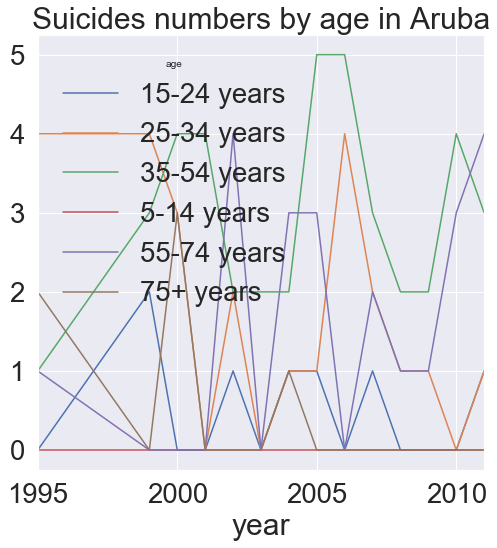

...

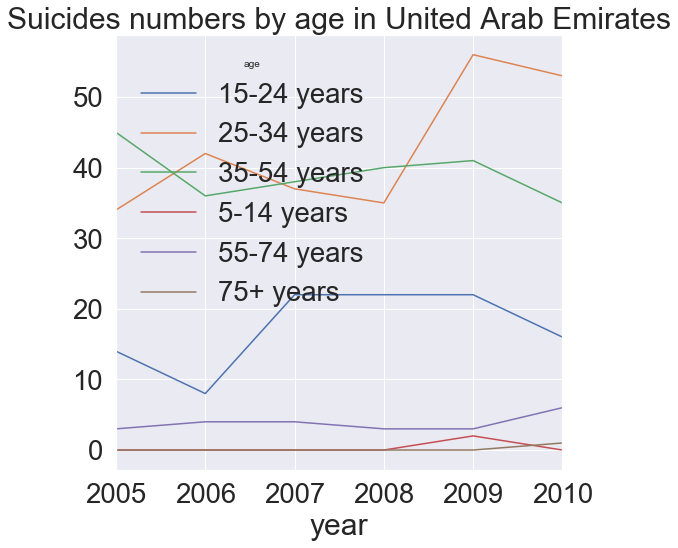

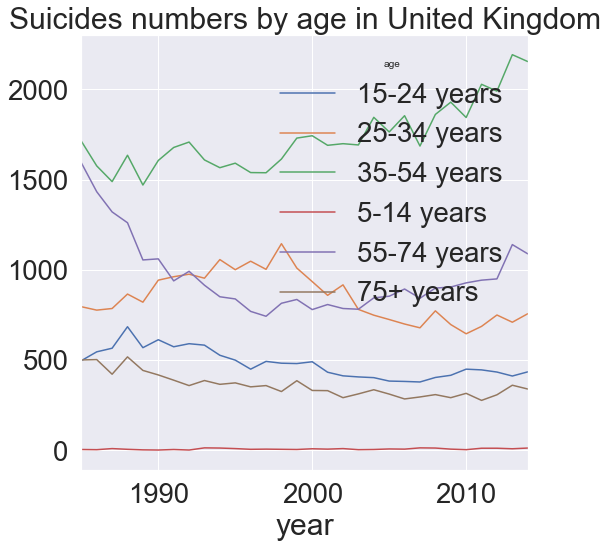

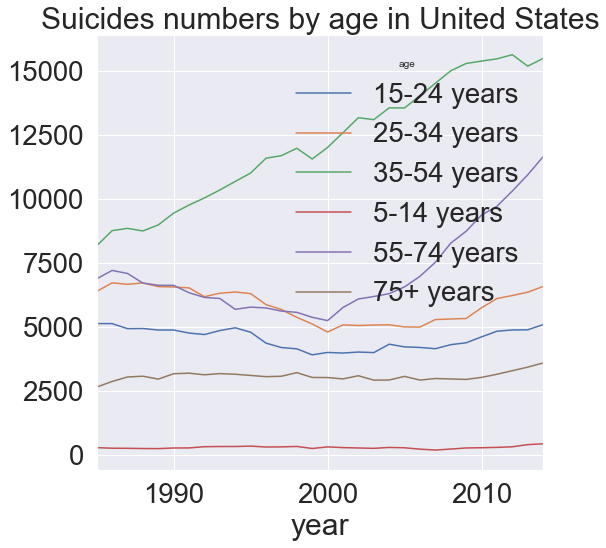

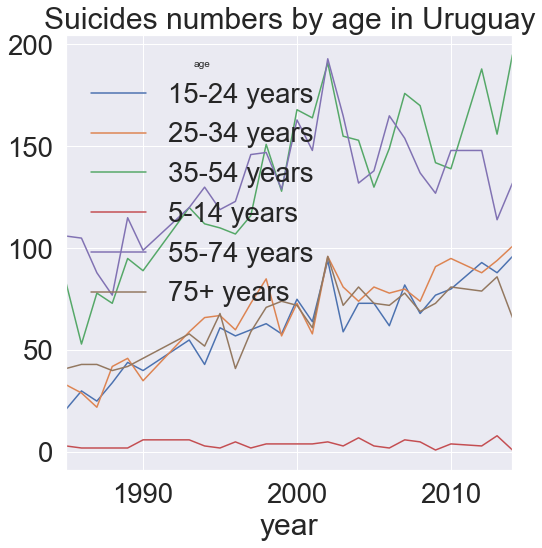

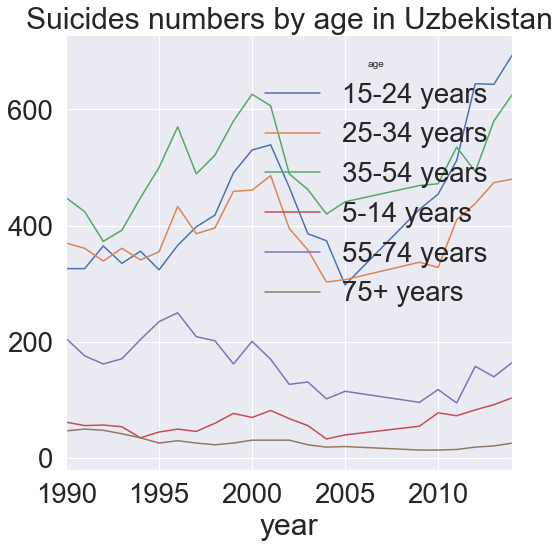

In [14]:
# 연령대에 따른 자살건수
for country in train.country.unique():
    grouped = train[train['country'] == country].groupby(['year', 'age'])['suicides_no'].sum().unstack('age')
    grouped.plot(figsize=(8, 8),
               title='Suicides numbers by age in '+ country,
               legend=True)

In [15]:
train.year.min(), train.year.max()

(1985, 2014)

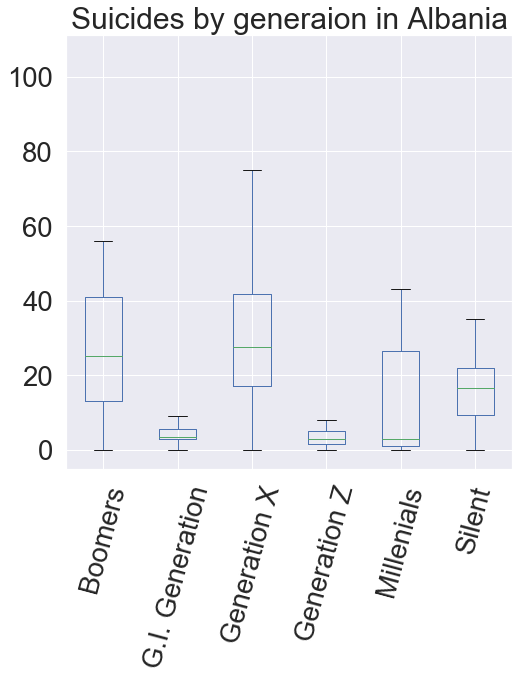

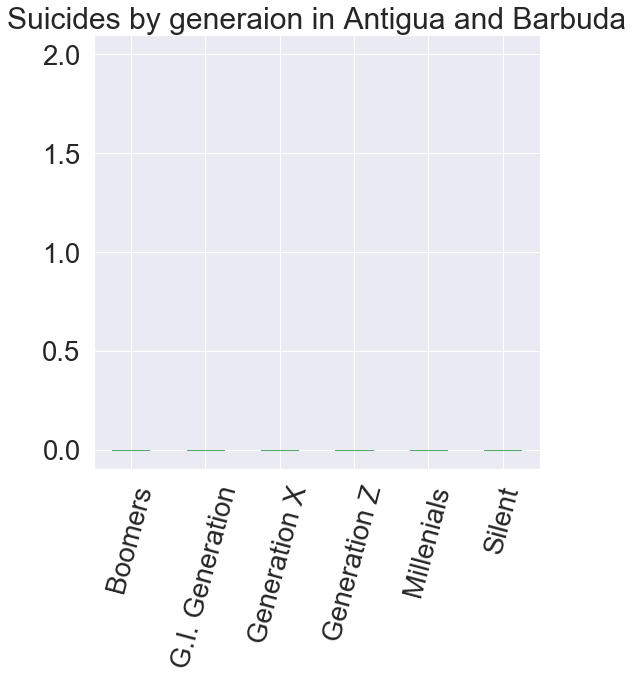

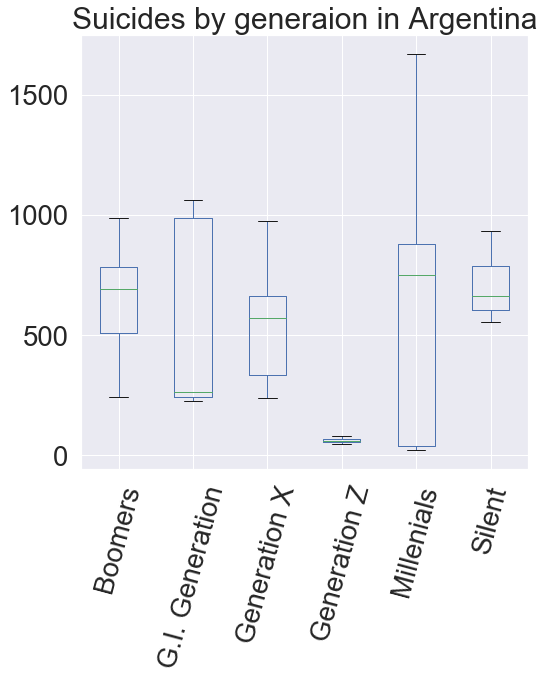

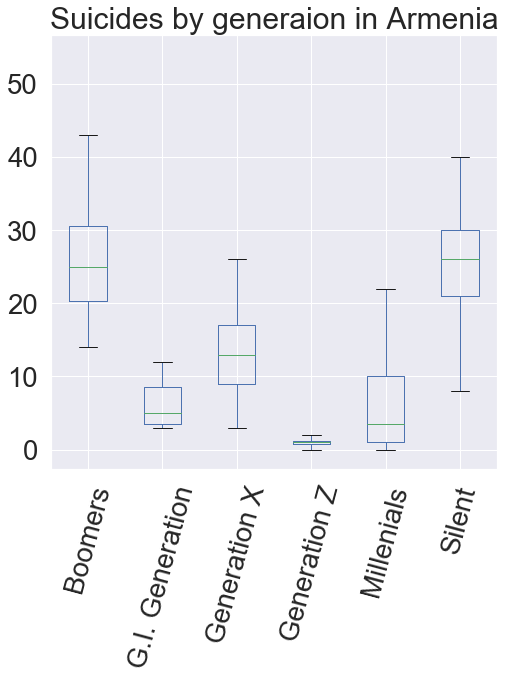

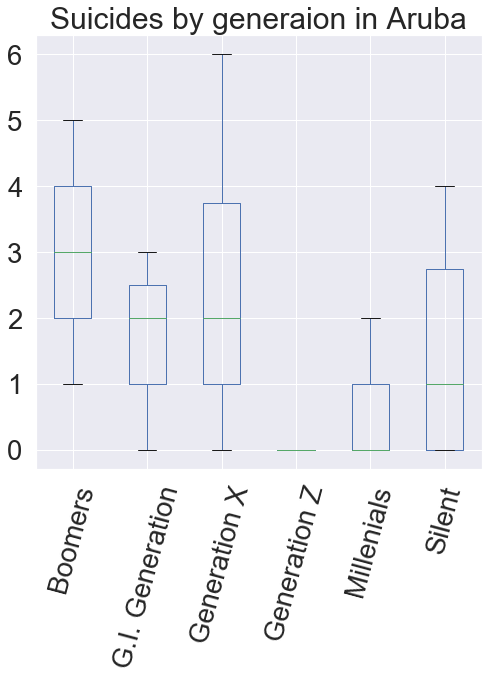

...

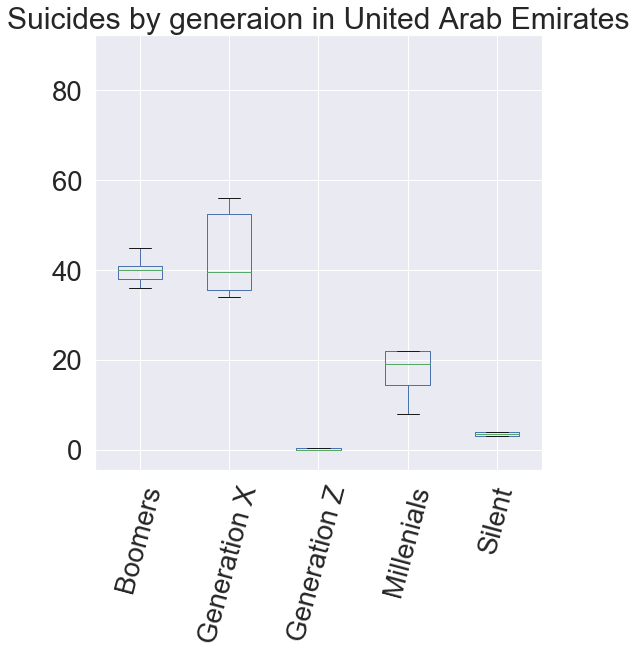

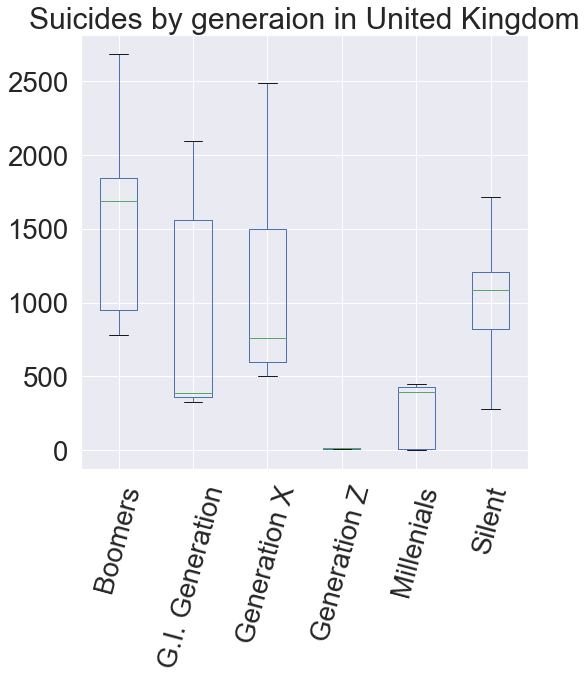

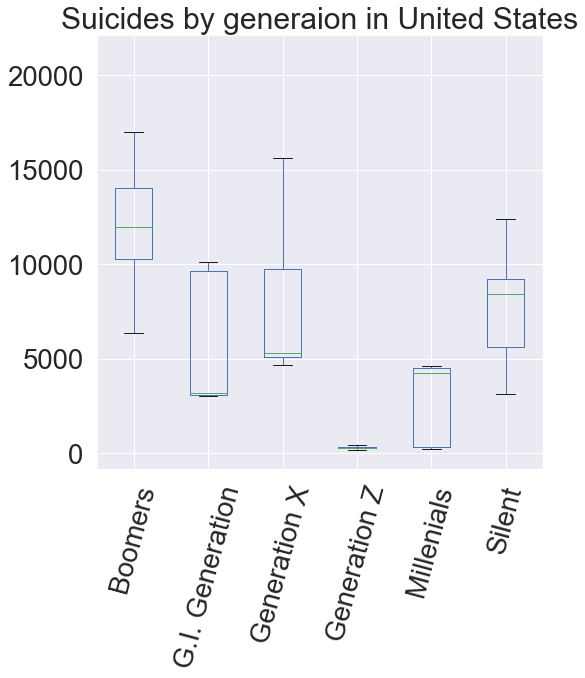

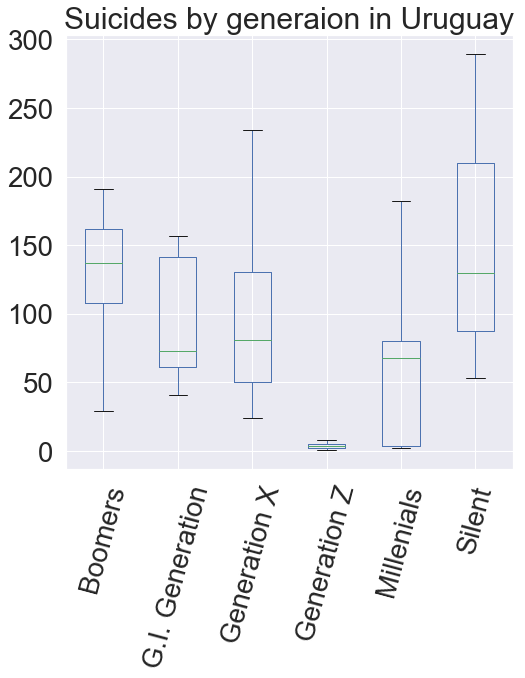

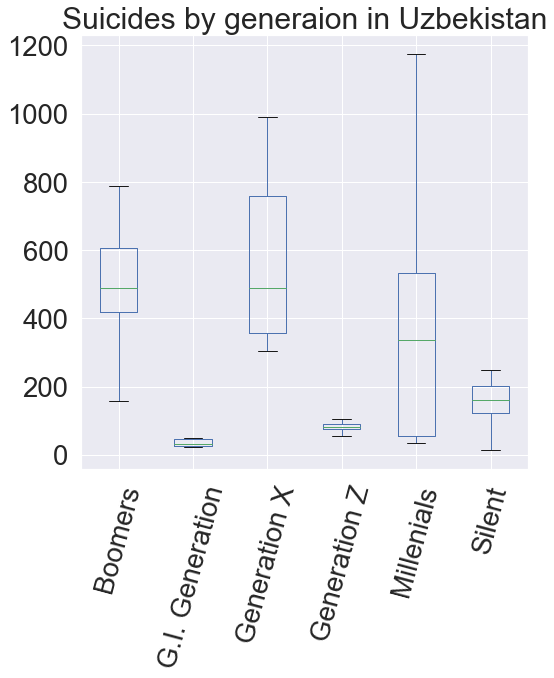

In [16]:
for country in train.country.unique():
    grouped = train[train['country'] == country].groupby(['year', 'generation'])['suicides_no'].sum().unstack('generation')
    grouped.plot.box(figsize=(8, 8),
                     title='Suicides by generaion in '+ country,
                     legend=True)
    plt.xticks(rotation=75)

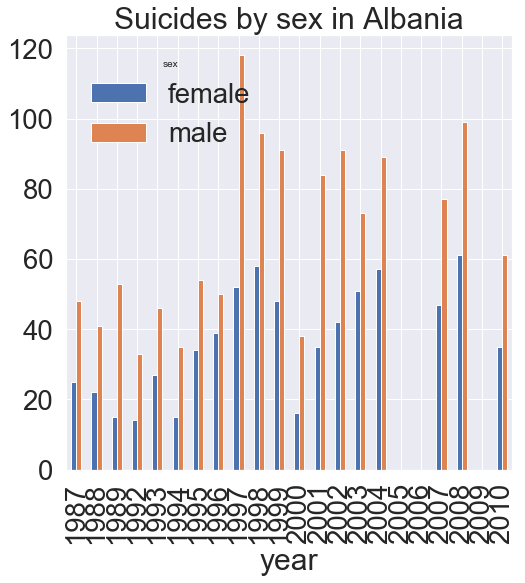

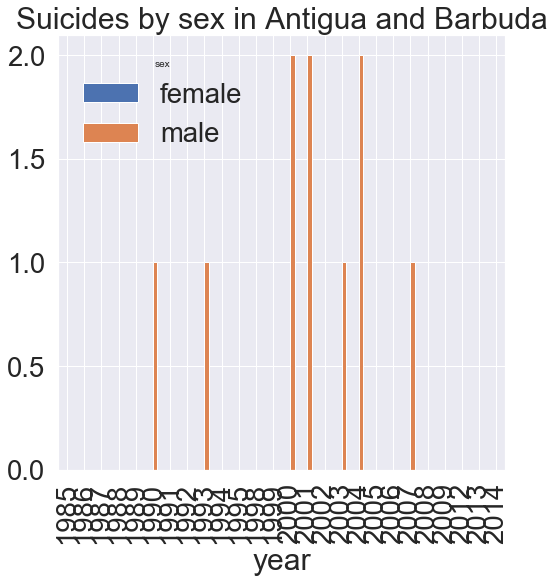

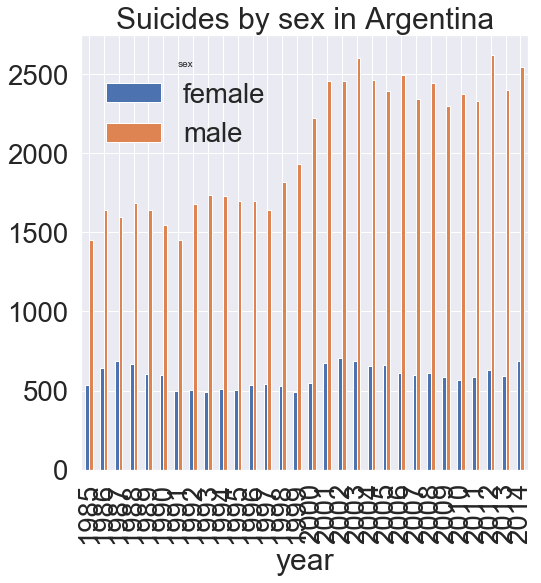

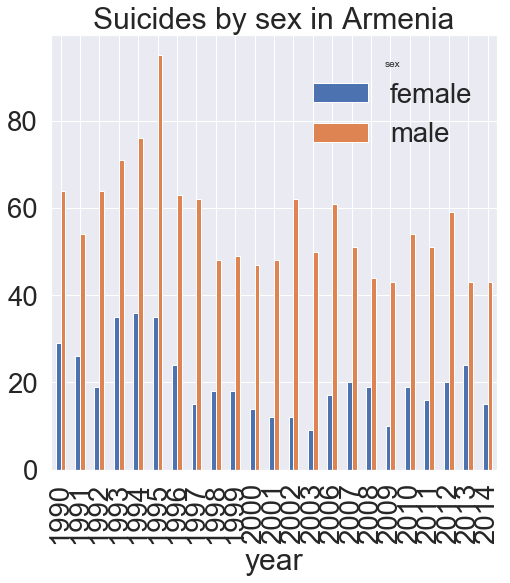

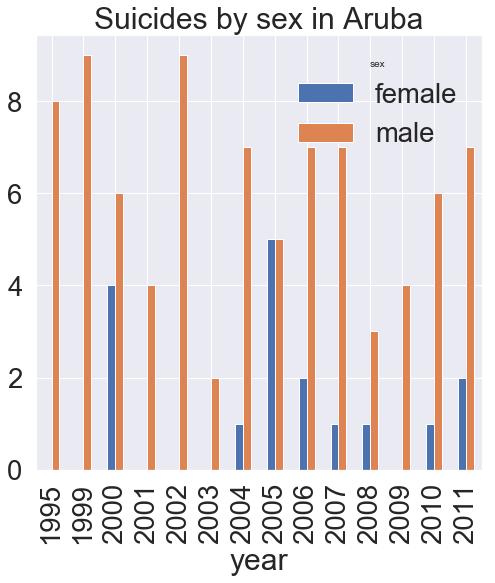

...

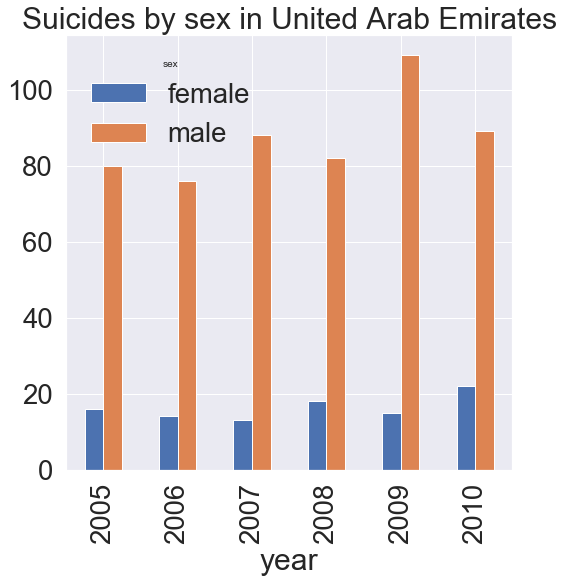

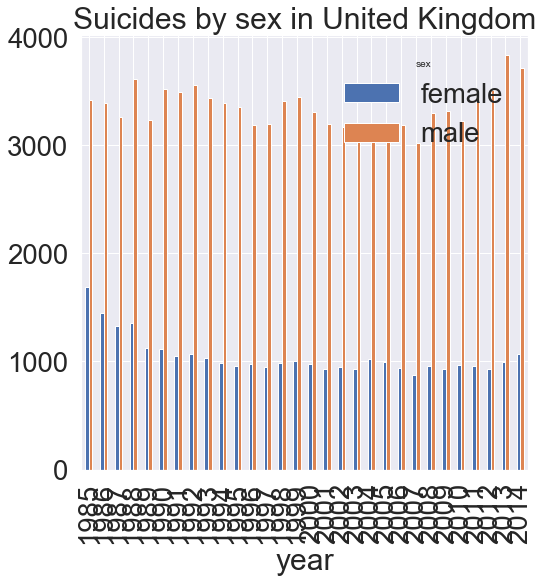

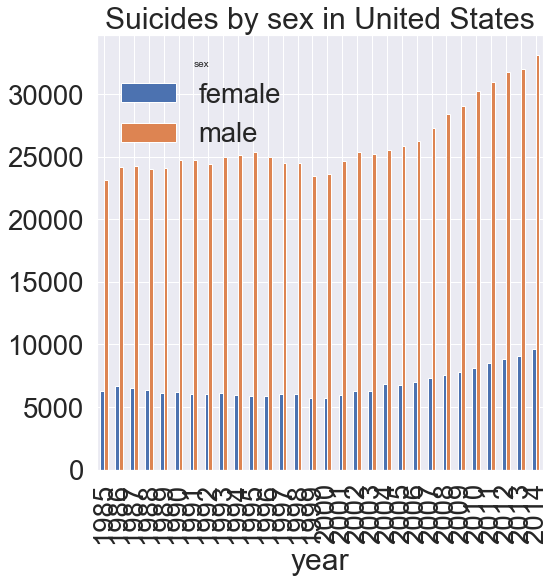

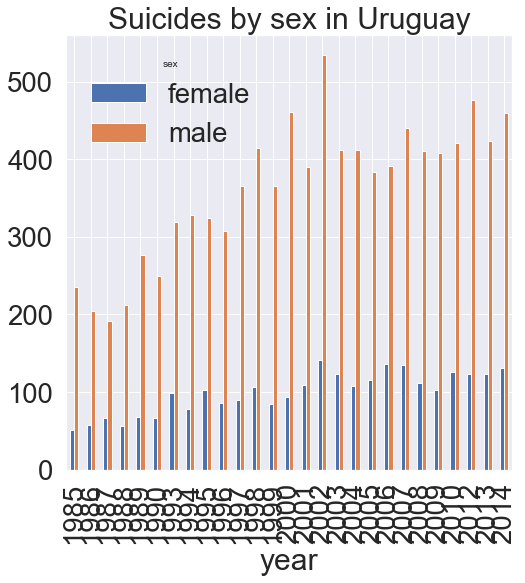

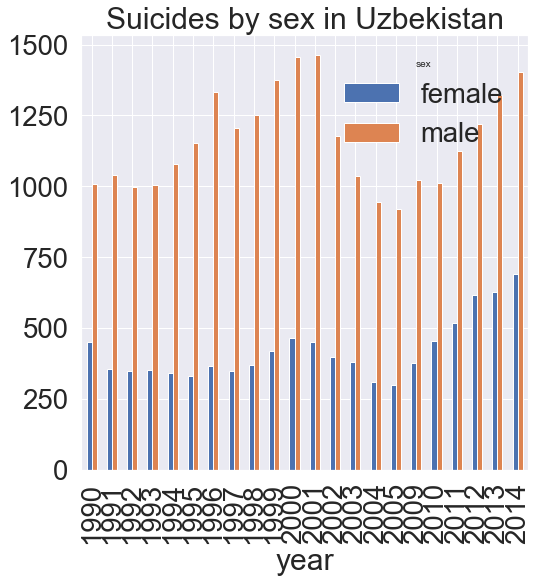

In [17]:
for country in train.country.unique():
    grouped = train[train['country'] == country].groupby(['year', 'sex'])['suicides_no'].sum().unstack('sex')
    grouped.plot.bar(figsize=(8, 8),
                     title='Suicides by sex in '+ country,
                     legend=True)

In [19]:
# 이게 누락되어 있었음
sample= pd.read_csv('./sample.csv')

In [20]:
sample.head()

,country,y_pred
0,Albania,35.977640
1,Antigua and Barbuda,8.352893
2,Argentina,10.157314
3,Armenia,27.624467
4,Aruba,69.397970


In [21]:
sample.iloc[sample['y_pred'].sort_values(ascending=False).index,:]

,country,y_pred
64,Norway,99.534455
57,Mauritius,98.872601
9,Bahrain,97.560188
5,Australia,96.751893
73,Republic of Korea,95.987919
27,Dominica,95.014221
14,Bosnia and Herzegovina,91.803956
34,Georgia,90.116904
82,Singapore,87.603717
28,Ecuador,86.042559


In [22]:
train[train.generation == 'Boomers']

,country,year,sex,age,suicides_no,population,suicides_100k_pop,country_year,HDI_for_year,gdp_for_year,gdp_per_capital,generation
4,Albania,1987,male,25-34 years,9,274300,3.28,Albania1987,NaN,2.156625e+09,796,Boomers
7,Albania,1987,female,25-34 years,4,257200,1.56,Albania1987,NaN,2.156625e+09,796,Boomers
19,Albania,1988,female,25-34 years,5,262400,1.91,Albania1988,NaN,2.126000e+09,769,Boomers
20,Albania,1988,male,25-34 years,5,279900,1.79,Albania1988,NaN,2.126000e+09,769,Boomers
25,Albania,1989,male,25-34 years,18,283600,6.35,Albania1989,NaN,2.335125e+09,833,Boomers
31,Albania,1989,female,25-34 years,2,266300,0.75,Albania1989,NaN,2.335125e+09,833,Boomers
36,Albania,1992,male,35-54 years,12,343800,3.49,Albania1992,NaN,7.094526e+08,251,Boomers
39,Albania,1992,male,25-34 years,7,245500,2.85,Albania1992,NaN,7.094526e+08,251,Boomers
41,Albania,1992,female,25-34 years,4,267400,1.50,Albania1992,NaN,7.094526e+08,251,Boomers
42,Albania,1992,female,35-54 years,2,323100,0.62,Albania1992,NaN,7.094526e+08,251,Boomers


## Feature Selection

In [25]:
X = train.drop(['suicides_no'],axis=1)  #independent columns
y = train['suicides_no']

In [26]:
from sklearn.feature_selection import SelectKBest
from sklearn.feature_selection import chi2

#apply SelectKBest class to extract top 10 best features
bestfeatures = SelectKBest(score_func=chi2, k=5)
fit = bestfeatures.fit(X,y)
dfscores = pd.DataFrame(fit.scores_)
dfcolumns = pd.DataFrame(X.columns)
#concat two dataframes for better visualization 
featureScores = pd.concat([dfcolumns,dfscores],axis=1)
featureScores.columns = ['Specs','Score']  #naming the dataframe columns
print(featureScores.nlargest(10,'Score'))  #print 10 best features

ValueError: could not convert string to float: 'Albania'

In [27]:
from sklearn.ensemble import ExtraTreesClassifier
import matplotlib.pyplot as plt
model = ExtraTreesClassifier()
model.fit(X,y)
#print(model.feature_importances_) #use inbuilt class feature_importances of tree based classifiers
#plot graph of feature importances for better visualization
feat_importances = pd.Series(model.feature_importances_, index=X.columns)
feat_importances.nlargest(15).plot(kind='barh')
plt.show()

ValueError: could not convert string to float: 'Albania'

In [28]:
from xgboost import XGBClassifier


from sklearn.model_selection import KFold
from sklearn.model_selection import cross_val_score
k_fold = KFold(n_splits=10, shuffle=True, random_state=0)

target = train['suicides_no']

clf = XGBClassifier()
scoring = 'accuracy'
score = cross_val_score(clf, train, target, cv=k_fold, n_jobs=1, scoring=scoring)
print(score)

print('Accuracy score:'+round(np.mean(score)*100,2))


ValueError: DataFrame.dtypes for data must be int, float or bool.
                Did not expect the data types in fields country, sex, age, country_year, generation